In [ ]:
"""
Written and maintained by Andreas Mentzelopoulos
Copyright (c) 2025, Andreas Mentzelopoulos. All Rights Reserved.

This code is the exclusive property of Andreas Mentzelopoulos
All associated materials (data, models, scripts) are the
exclusive property of Andreas Mentzelopoulos and LOBSTgER.

No part of this code may be copied, distributed, modified, or used in any
form without the prior written consent of Andreas Mentzelopoulos.

For permission requests, contact: Andreas Mentzelopoulos, ament@mit.edu.
"""

In [ ]:
!nvidia-smi

In [1]:
from helpers.read_data_tools import read_data
from helpers.pre_trained_autoencoder import load_autoencoder, encode, decode
from helpers.train_utils import read_checkpoint, clean, print_training_logs, write_checkpoint, update_ema, load_model
from helpers.diffusion_utils_conditional import *
from helpers.artificial_corruption_utils import *
from model_architectures import UnconditionalUNet, ConditionalUNet
from helpers.plotting_utils import plot_image

from tqdm import tqdm
from torch.cuda.amp import autocast, GradScaler
import numpy as np
import matplotlib.pyplot as plt

In [2]:
## Load data
img_dir = "images"
H, W = 512, 768
train_images, train_labels, test_images, test_labels = read_data(root_dir = img_dir, H = H, W = W)


Loading test Favorites: 100%|██████████| 48/48 [00:02<00:00, 23.21it/s]


In [3]:

autoencoder = load_autoencoder(half_precision = True)

In [ ]:
## Make dataloader
train_loader = renew_dataloader(batch_list = train_images, batch_labels = train_labels, autoencoder = autoencoder, batch_size = 64)
save_dataset(train_loader)

In [2]:
#### Model & Hyperparameters

import torch
import torch.optim as optim
device = "cuda"

NUM_EPOCHS = 25000
TOTAL_TIMESTEPS = 1000
beta_t = cosine_beta_schedule(TOTAL_TIMESTEPS)
cfg_dropout = 0.25

# Create the Unet model
model = ConditionalUNet(dim = 128, dim_mults = (1,2), beta_t = beta_t).to(device)
optimizer = optim.AdamW(model.parameters(), lr=5e-4)
scheduler = None

scaler = GradScaler()
mixed_precision = True

ema_decay = 0.995


In [3]:
checkpoint_path = "model_checkpoints/demo_model.pth"
epoch_start, ema_params, losses_total, train_loader = read_checkpoint(checkpoint_path = checkpoint_path, 
                                                                     model = model,
                                                                     optimizer = optimizer)




Model number of parameters: 11766444


In [ ]:
# Training Loop
model.train()
clean()
for epoch in range(epoch_start+1, NUM_EPOCHS):
    
    train_losses = []
    for i, (batch_conditions, batch_targets, batch_classes) in enumerate(tqdm(train_loader)):

        batch_conditions = batch_conditions.half().to(device)
        batch_targets = batch_targets.half().to(device)
        #batch_classes = batch_classes.to(device)
        #print(batch_conditions.shape)
        #print(batch_conditions.dtype)
        
        e = torch.randn_like(batch_targets)
        t = sample_t(bad_data = False, TOTAL_TIMESTEPS = TOTAL_TIMESTEPS, batch_targets = batch_targets)
        x_t, v_t = forward_sample(x_0 = batch_targets, t=t, e=e, alphas_cumprod = alphas_cumprod) # Calculates velocity

        # set to null token for unconditional model
        rand_ind = torch.randperm(batch_conditions.shape[0])[:int(cfg_dropout * batch_conditions.shape[0])]
        batch_conditions[rand_ind] = model.class_tokens.to(dtype = batch_conditions.dtype)

        optimizer.zero_grad()

        if mixed_precision:
            with torch.cuda.amp.autocast():
                v_pred = model(x_t, batch_conditions, t)
                loss = torch.nn.functional.mse_loss(v_t, v_pred)
             
            if torch.isnan(loss): # If crash   
                #assert False
                model.load(load_state_dict(checkpoint['model_state_dict'], strict=False))
                for param_group in optimizer.param_groups:
                   param_group['lr'] /= 2 
                continue
                
            scaler.scale(loss).backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            scaler.step(optimizer)
            scaler.update()

        else:
            v_pred = model(x_t, batch_conditions, t)
            loss = F.mse_loss(v_t, v_pred)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            optimizer.step()

        if epoch > 10:
            update_ema(model = model, ema_params = ema_params, ema_decay = ema_decay)
        train_losses.append(loss.item())  # Store the original loss

    if scheduler:
        scheduler.step()
    losses_total.append(np.mean(train_losses))
    print(f"Epoch: {epoch+1} Train Loss: {np.mean(train_losses)}")
    
    if (epoch+1) % 50 == 0:
        print_training_logs(epoch = epoch, losses_total = losses_total, optimizer = optimizer)

    if (epoch+1) % 100 == 0 and epoch != 0:

        model_name = "demo_model"
        write_checkpoint(epoch = epoch, model = model, optimizer = optimizer, ema_params = ema_params, losses_total = losses_total, train_loader = train_loader,
                   scheduler = None, scaler = None)

        #sample_and_save_images(model, epoch+1, num_samples=10, channels=4)
        #print(f"Generated samples at epoch: {epoch+1}")

    if (epoch+1) % 10 == 0 and epoch != 0:
        #update_dataloader(train_loader)
        #train_loader = renew_dataloader()
        clean()

100%|██████████| 7/7 [00:06<00:00,  1.13it/s]


Epoch: 1 Train Loss: 0.9039232645715986


100%|██████████| 7/7 [00:04<00:00,  1.66it/s]


Epoch: 2 Train Loss: 0.772338262626103


100%|██████████| 7/7 [00:04<00:00,  1.65it/s]


Epoch: 3 Train Loss: 0.7504532762936184


100%|██████████| 7/7 [00:04<00:00,  1.65it/s]


Epoch: 4 Train Loss: 0.7053913133484977


100%|██████████| 7/7 [00:04<00:00,  1.65it/s]


Epoch: 5 Train Loss: 0.6833044290542603


100%|██████████| 7/7 [00:04<00:00,  1.65it/s]


Epoch: 6 Train Loss: 0.6680283290999276


100%|██████████| 7/7 [00:04<00:00,  1.65it/s]


Epoch: 7 Train Loss: 0.663545983178275


100%|██████████| 7/7 [00:04<00:00,  1.65it/s]


Epoch: 8 Train Loss: 0.6330004504748753


100%|██████████| 7/7 [00:04<00:00,  1.65it/s]


Epoch: 9 Train Loss: 0.5894512363842556


100%|██████████| 7/7 [00:04<00:00,  1.65it/s]


Epoch: 10 Train Loss: 0.5675857407706124


100%|██████████| 7/7 [00:05<00:00,  1.36it/s]


Epoch: 11 Train Loss: 0.5481136185782296


100%|██████████| 7/7 [00:04<00:00,  1.63it/s]


Epoch: 12 Train Loss: 0.5257537535258702


  0%|          | 0/7 [00:00<?, ?it/s]

In [4]:
model = ConditionalUNet(dim = 64, dim_mults = (1,2,4,8))
load_model(model = model)
model = model.eval().to("cuda")

Generating images:: 100%|██████████| 1000/1000 [00:36<00:00, 27.13it/s]


####################

###############


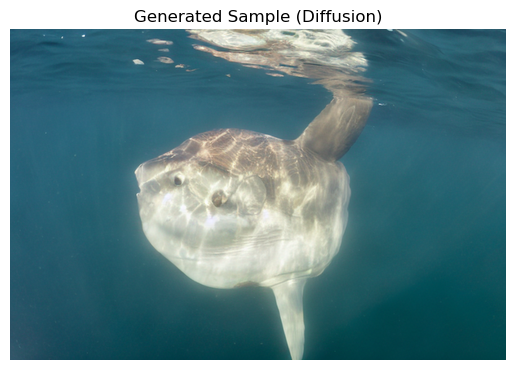

####################

###############


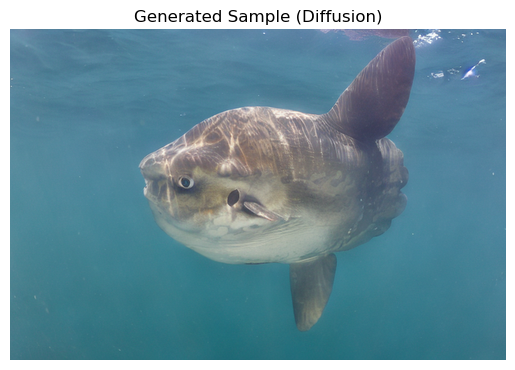

####################

###############


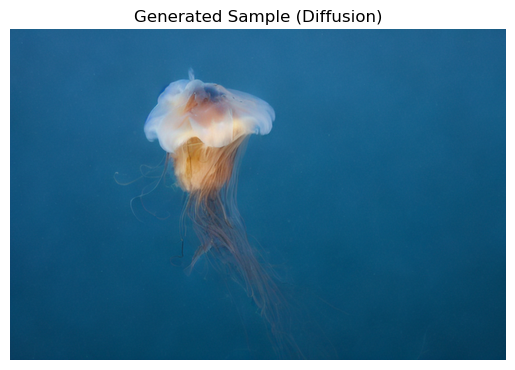

####################

###############


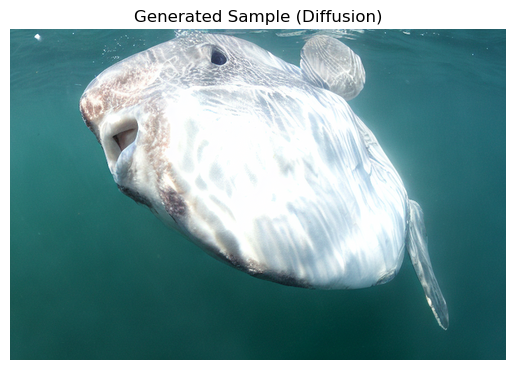

####################

###############


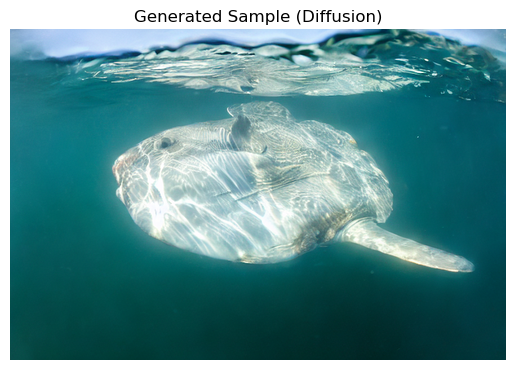

####################

###############


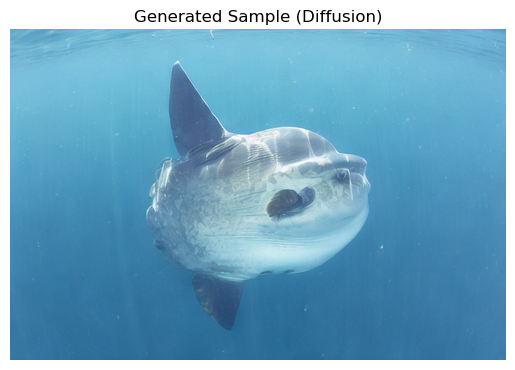

####################

###############


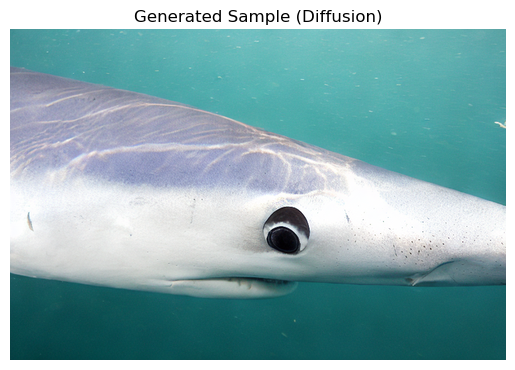

####################

###############


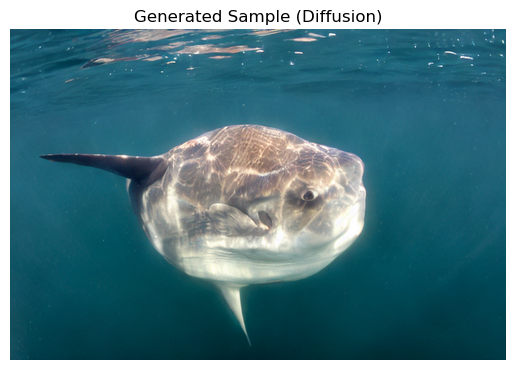

####################

###############


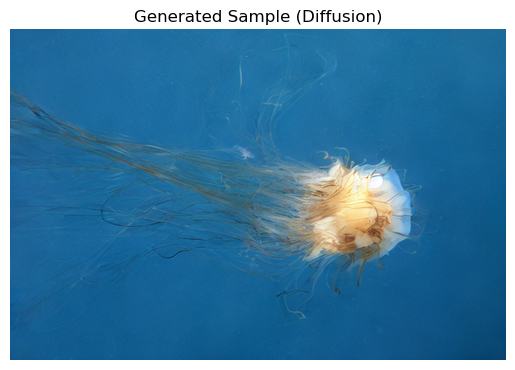

####################

###############


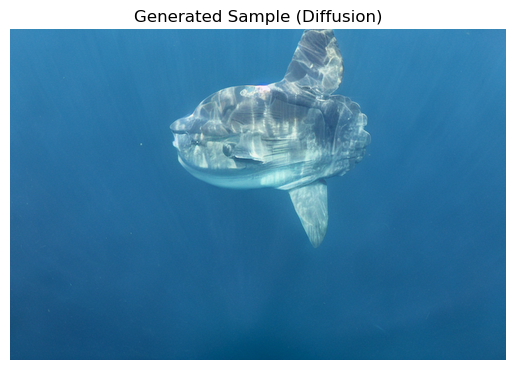

####################

###############


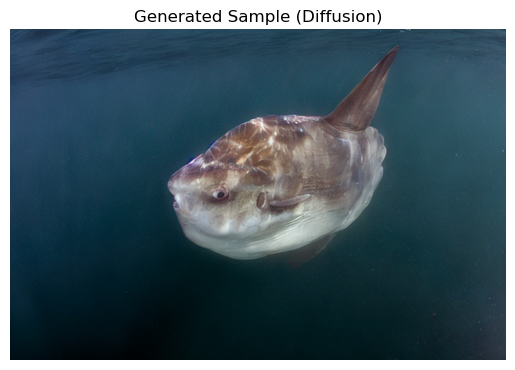

####################

###############


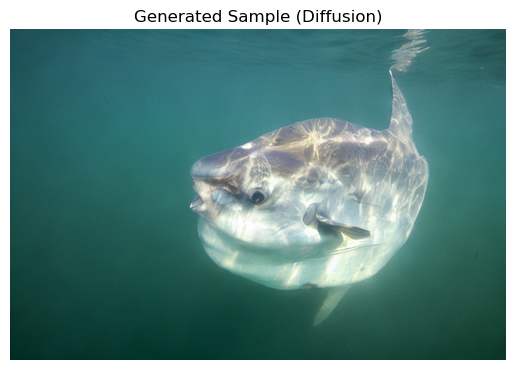

####################

###############


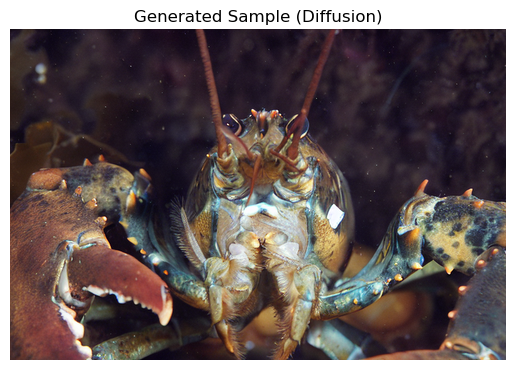

####################

###############


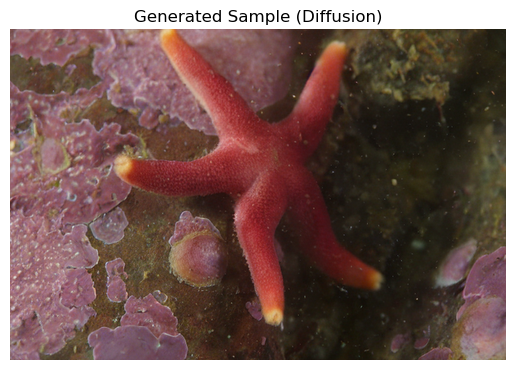

####################

###############


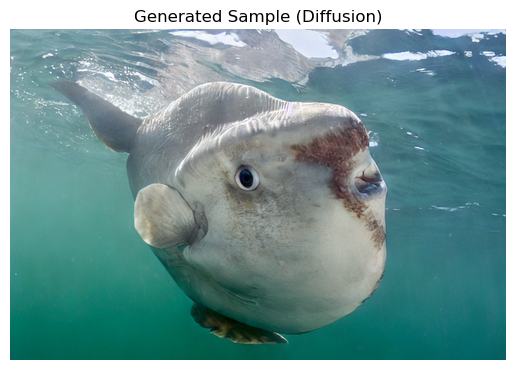

####################

###############


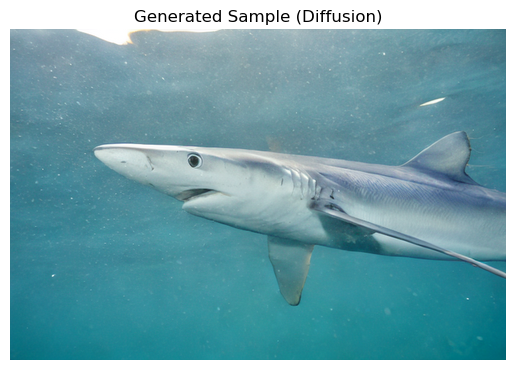

In [25]:
# Print a single sample of the generated images

with torch.no_grad():

    
    # From test data
    
    ind = torch.randint(low=0, high=len(test_images)-1, size=(16,))
    ind = ind.tolist()  # Convert indices to a list
    selected_images = [test_images[i] for i in ind]
    corrupted_image = corrupt_individually(torch.stack(selected_images), add_bubbles = False, motion_blur = False, blur_kernel_size = [2,4,8,16], apply_inpainting = True) #, p_inpainting = 1)
    #corrupted_image = FF.hflip(corrupted_image)
    
    ## From external
    '''
    ind = random.sample(range(len(batch_new_england)), 16)  # Pick N unique indices 
    #ind = [15]*4
    #ind = [0,0,0,0,4,4,4,4,15,15,15,15,18,18,18,18] #torch.randint(low = 0, high = corrupted_images.shape[0], size = (1,)) #0, 1,3,9, 14, 17, 25
    #plot_image(batch_new_england[ind[i]])
    corrupted_image = corrupt_individually(batch_new_england[ind], add_bubbles = False, motion_blur = False, blur_kernel_size = [2,4,8], apply_inpainting = False)  
    #corrupted_image = FF.hflip(corrupted_image)
    '''
    
    # For unconditional
    corrupted_image = None

    samples = sample(model = model, autoencoder = autoencoder, corrupted_img = corrupted_image, quick = False, num_timesteps = 250, cfg_guidance = False, cfg_scale = 2)
    samples = samples[-1]

    for i in range(samples.shape[0]):

        print("####################\n\n###############")

        if corrupted_image is not None:
           plot_image(corrupted_image[i])

        r_samples = samples[[i]]
        #print("Samples tensor shape: ", r_samples.shape)
        #print("Generated Latent in (expected in [-3,3]):", r_samples.max(), r_samples.min(), r_samples.shape)
        r_samples = decode(z = r_samples, autoencoder = autoencoder).float()
        #print("Generated Image max/min:", r_samples.max().item(),r_samples.min().item(), r_samples.shape)
        
        plot_image(r_samples[0], title = "Generated Sample (Diffusion)")

        #closest_sample = find_closest_in_training(r_samples.squeeze().cpu())
        #plot_image(closest_sample)
        #plot_image(selected_images[i], f"GT, {i}")
        #plot_image(batch_new_england[ind][i], f"GT, {ind[i]}")
        
        '''
        tosave_img = r_samples.squeeze().detach().cpu().numpy()
        tosave_img = tosave_img.transpose(1,2,0)
        tosave_img = (tosave_img*255).astype('uint8')
        tosave_img = Image.fromarray(tosave_img)
        tosave_img.save('./Generated_Jelly/myJelly' + str(i) +'.png')
        
    '''
    '''
    for i in range(samples.shape[0]):
            print("####################\n\n###############")
            
            if corrupted_image is not None:
                plot_image(corrupted_image[i], title="Corrupted")
        
            r_samples = samples[[i]]
            r_samples = decode(r_samples).float()
        
            gt = selected_images[i]
            gen = r_samples[0]
        
            # Compute difference image
            diff = torch.abs(gen - gt)
        
            # Plot all three in one row
            fig, axs = plt.subplots(1, 3, figsize=(18, 6))
            axs[0].imshow(gen.permute(1, 2, 0).cpu().clamp(0, 1))
            axs[0].set_title("Generated")
            axs[0].axis('off')
        
            axs[1].imshow(gt.permute(1, 2, 0).cpu().clamp(0, 1))
            axs[1].set_title("Ground Truth")
            axs[1].axis('off')
        
            axs[2].imshow(diff.permute(1, 2, 0).cpu().clamp(0, 1))
            axs[2].set_title("Absolute Difference")
            axs[2].axis('off')
        
            plt.tight_layout()
            plt.show()
    '''

In [ ]:


# Load Data
checkpoint = torch.load("./models/demo3.pth")
model.load_state_dict(checkpoint['model_state_dict'], strict=False)
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
losses_total = checkpoint['losses_total']

data = torch.load('latent_dataset.pt')
dataset = LatentDataset(
    train_conditions=data['train_conditions'],
    train_targets=data['train_targets'],
    train_classes=data['classes']
)
train_loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)

# We will use the following variance schedule for our diffusion model
beta_t = torch.linspace(0.0001, 0.02, TOTAL_TIMESTEPS)

In [6]:
# Define the helper funtcions used for the reverse process and scaling

def reverse_sample(model, x, t, t_index):
    def extract(a, t, x_shape):
      return a.gather(-1, t.cpu()).reshape(t.shape[0], *((1,) * (len(x_shape) - 1))).to(t.device)
    alphas = 1. - beta_t
    alphas_cumprod = torch.cumprod(alphas, axis=0)
    alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
    sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
    sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
    sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
    beta_tilde_t = beta_t * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)
    beta_tilde_t = extract(beta_tilde_t, t, x.shape)
    ########################
    alphas = 1. - beta_t
    alphas_cumprod = torch.cumprod(alphas, axis=0)
    betas = extract(beta_t, t, x.shape)
    sqrt_one_minus_alphas_cumprod = extract(torch.sqrt(1. - alphas_cumprod), t, x.shape)
    sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
    sqrt_recip_alphas_t = extract(sqrt_recip_alphas, t, x.shape)
    mu_tilde_t = sqrt_recip_alphas_t * (x - betas * model(x, t) / sqrt_one_minus_alphas_cumprod)
    ########################

    e = torch.randn_like(x)
    return mu_tilde_t + torch.sqrt(beta_tilde_t) * e 

@torch.no_grad()
def sample(model, H = 512//8, W = 768//8, num_samples = 8):
    shape = (num_samples, 4, H, W)
    img = torch.randn(shape, device=device)
    imgs = []
    for i in reversed(range(0, TOTAL_TIMESTEPS)):
        img = reverse_sample(model, img, torch.full((shape[0],), i, device=device, dtype=torch.long), i)
        imgs.append(img.cpu())
    return imgs
    
def sample_and_save_images(model, epoch, corrupted_img: torch.tensor):

    save_dir = f'./Training_samples/{epoch}'
    os.makedirs(save_dir, exist_ok=True)
    
    samples = sample(model, corrupted_img)
    samples = samples[-1]

    for i in range(num_samples):
        r_samples = decode(r_samples)
    
        tosave_img = r_samples.squeeze().detach().cpu().numpy().transpose(1,2,0).astype('uint8')
        tosave_img = Image.fromarray(tosave_img)
        tosave_img.save(os.path.join(save_dir, f'myJelly{i}.png'))

    model.train() # Ensure model returns to training mode
    return None

# Function that accepts an image (not latent) and finds the closest in the training set 
@torch.no_grad()
def find_closest_in_training(sample, imgs = train_images):
    assert sample.ndim == 3
    min_dist = float("inf")
    for i, img in enumerate(imgs):
        dist = torch.sqrt(torch.sum((sample.cpu() - img) ** 2))
        if dist < min_dist:
            min_dist = dist
            indx = i
    return imgs[indx]


In [ ]:
#### Model & Hyperparameters

NUM_EPOCHS = 100000

## Number of timesteps & variance schedule
TOTAL_TIMESTEPS = 1000
beta_t = cosine_beta_schedule(TOTAL_TIMESTEPS)
alphas = 1. - beta_t
alphas_cumprod = torch.cumprod(alphas, axis=0).to(device)

# Create the Unet model
model = Unet(dim = 128, channels=4, dim_mults=(1, 2, 4)).to(device)
optimizer = optim.Adam(model.parameters(), lr=5e-4)

# Load Data
checkpoint = torch.load("./models/demo3.pth")
model.load_state_dict(checkpoint['model_state_dict'], strict=False)
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
losses_total = checkpoint['losses_total']

data = torch.load('latent_dataset.pt')
dataset = LatentDataset(
    train_conditions=data['train_conditions'],
    train_targets=data['train_targets'],
    train_classes=data['classes']
)
train_loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)

# We will use the following variance schedule for our diffusion model
beta_t = torch.linspace(0.0001, 0.02, TOTAL_TIMESTEPS)

In [ ]:
NUM_EPOCHS = 100000
learning_rate = 8e-4

TOTAL_TIMESTEPS = 1000 # Diffusion time-steps
beta_t = cosine_beta_schedule(TOTAL_TIMESTEPS)#.to(device) ## Cosine beta schedule
alphas = 1. - beta_t ## alphas
alphas_cumprod = torch.cumprod(alphas, axis=0).to(device) ## alphas_bar

# Create the Unet model
model = Unet(dim = 128, channels=4, dim_mults=(1, 2, 4)).to(device) # Terro Karras
optimizer = optim.AdamW(model.parameters(), lr=learning_rate)
# Data

checkpoint = torch.load("./models/demo3.pth")
model.load_state_dict(checkpoint['model_state_dict'], strict=False)
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
losses_total = checkpoint['losses_total']

data = torch.load('latent_dataset.pt')
dataset = LatentDataset(
    train_conditions=data['train_conditions'],
    train_targets=data['train_targets'],
    train_classes=data['classes']
)
train_loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)




#losses_total = []
for epoch in tqdm(range(len(losses_total)+1, NUM_EPOCHS)):
    train_losses = []
    for (_, X, _) in train_loader:
        optimizer.zero_grad()
        batch_size = X.shape[0]
        batch = X.float().to(device)
        
        t = torch.randint(0, TOTAL_TIMESTEPS, (batch_size,), device=device).long()
        
        e = torch.randn_like(batch)
        x_t = forward_sample(batch, t=t, e=e)
        e_pred = model(x_t, t)
        loss = F.mse_loss(e, e_pred)
        
        # Gradient step
        train_losses.append(loss.item())
        loss.backward()
        optimizer.step()

    if (epoch+1) % 5 == 0:
    
        plt.clf()
        plt.plot(losses_total, label="Training")
        #plt.plot(test_losses_total, label="Testing")
        plt.ylim(0.01, 0.2)
        plt.grid()
        plt.ylabel("MSE Loss")
        plt.xlabel("Epoch")
        plt.savefig("Loss.png")

    if (epoch+1) % 50 == 0 and epoch != 0:
        
        save_path = "./models/"
        save_name = "./demo3.pth"
        torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'losses_total': losses_total
        }, save_path + save_name)
        print(f"Model saved, epoch: {epoch+1}")

        print("Epoch: {} Loss: {}".format(epoch, np.mean(train_losses)))
    losses_total.append(np.mean(train_losses))

  0%|          | 1/95701 [00:44<1192:45:14, 44.87s/it]

Model saved, epoch: 4300
Epoch: 4299 Loss: 0.06988759663488184


  0%|          | 17/95701 [07:47<704:06:31, 26.49s/it]

In [14]:
save_path = "./models/"
save_name = "./demo3.pth"
torch.save({
    'epoch': epoch,
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'losses_total': losses_total
}, save_path + save_name)
print(f"Model saved, epoch: {epoch+1}")

Model saved, epoch: 3361


In [7]:
checkpoint = torch.load("./models/demo3.pth")
model = Unet(dim = 128, channels=4, dim_mults=(1, 2, 4)).to(device)
model.load_state_dict(checkpoint['model_state_dict'], strict=False)
#optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
#losses_total = checkpoint['losses_total']
TOTAL_TIMESTEPS = 1000
beta_t = torch.linspace(0.0001, 0.02, TOTAL_TIMESTEPS)

torch.Size([1, 3, 512, 768])
torch.float32


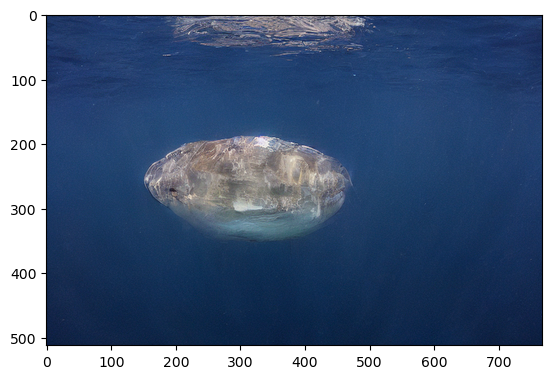

torch.Size([1, 3, 512, 768])
torch.float32


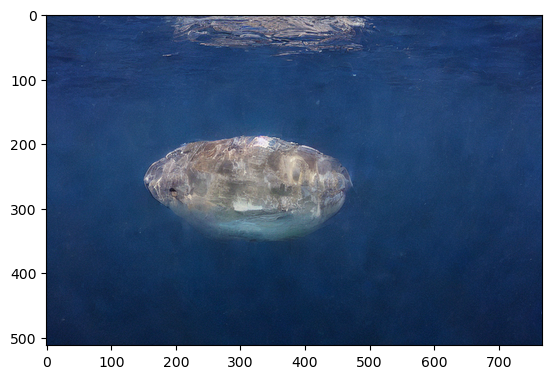

torch.Size([1, 3, 512, 768])
torch.float32


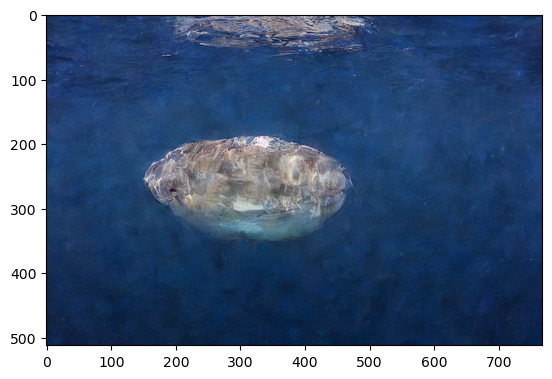

torch.Size([1, 3, 512, 768])
torch.float32


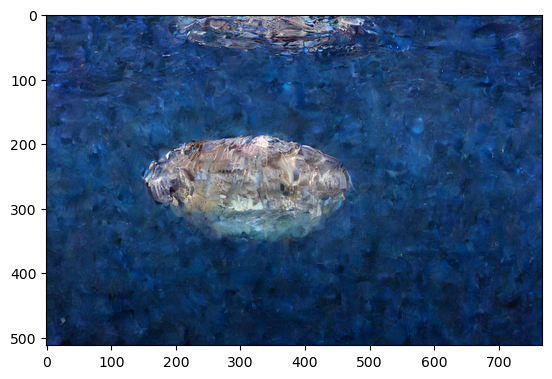

torch.Size([1, 3, 512, 768])
torch.float32


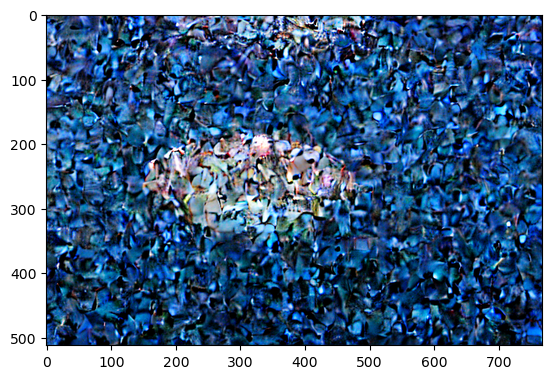

torch.Size([1, 3, 512, 768])
torch.float32


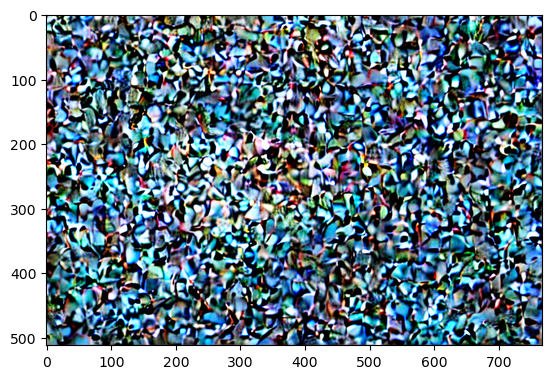

torch.Size([1, 3, 512, 768])
torch.float32


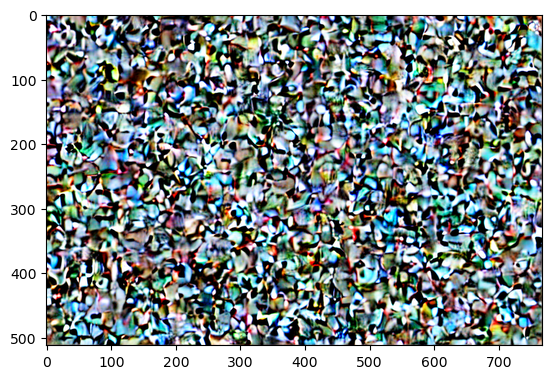

In [17]:
samples = sample(model)
for t in [999, 999-25, 999-50, 999-100, 999-250, 999-500, 999-999]:
    latent = torch.tensor(samples[t])
    img = decode(latent).float()
    print(img.shape)
    print(img.dtype)
    plt.imshow(img.squeeze().permute(1,2,0).numpy(), interpolation = "lanczos")
    plt.show()

In [ ]:
# Train the diffusion model with gradient accumulation and EMA decay
# Use a linear variance schedule
# We use a Unet architecture (Tero Karras)
# Adding time steps makes it slower but improves the accuracy of the Unet by a lot!


# Parameters
NUM_EPOCHS = 150000
learning_rate = 5e-4 ## 8e-4 bad_data_3
ema_decay = 0.995  
cfg_dropout = 0.25
bad_class_time_fraction = 0.5

# Device
device = "cuda" if torch.cuda.is_available() else "cpu"

# Model Architecture
model = ConditionedUNet(dim = 64, dim_mults = (1,2,4,8), num_classes = 1) 
 
# Optimizer and Step scheduler
optimizer = optim.AdamW(model.parameters(), lr=learning_rate)
scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=NUM_EPOCHS)

#Gradient scaler for mixed precision
scaler = GradScaler()
mixed_precision = False

# Resume from checkpoint if available
checkpoint_path = "./models/DeepUnderWaterDiffuser_bad_data_5.pth"
if os.path.exists(checkpoint_path):
    checkpoint = torch.load(checkpoint_path)
    epoch_start = checkpoint['epoch']
    model.load_state_dict(checkpoint['model_state_dict'], strict=False)
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
    scaler.load_state_dict(checkpoint['scaler_state_dict'])
    ema_params = checkpoint['ema_params']
    losses_total = checkpoint['losses_total']

    # Move optimizer state to the correct device
    
    for state in optimizer.state.values():
        for k, v in state.items():
            if isinstance(v, torch.Tensor):
                state[k] = v.to(device)
    
    
    ## Load dataloader to resume
    data = torch.load('latent_dataset.pt')
    dataset = LatentDataset(
        train_conditions=data['train_conditions'],
        train_targets=data['train_targets'],
        train_classes=data['classes']
    )
    train_loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)

    for param_group in optimizer.param_groups:
       param_group['lr'] = learning_rate  
                
else:
    epoch_start = -1
    losses_total = []
    # Create a dictionary for EMA parameters
    ema_params = {name: param.detach().clone().to(device) for name, param in model.named_parameters()}
    #test_losses_total = []
    print("Warning: Checkpoint does not exist, starting from scratch!")
    #assert learning_rate/(batch_size*accumulation_steps) >= 8e-5/64, "Learning rate too small"
    ## Load dataloader to resume
    data = torch.load('latent_dataset.pt')
    dataset = LatentDataset(
        train_conditions=data['train_conditions'],
        train_targets=data['train_targets'],
        train_classes=data['classes']
    )
    train_loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)

model = model.to(device)
total_params = sum(p.numel() for p in model.parameters())
print(f"Total number of parameters: {total_params}")

# Clear memory
gc.collect()
torch.cuda.empty_cache()

# Training Loop
model.train()
for epoch in range(epoch_start+1, NUM_EPOCHS):
    
    train_losses = []

    if epoch > 0.8*NUM_EPOCHS:
        mixed_precision = True

    ## Training
    for i, (batch_conditions, batch_targets, batch_classes) in enumerate(tqdm(train_loader)):

        batch_conditions = batch_conditions.float().to(device) if not mixed_precision else batch_conditions.float().to(device)
        batch_targets = batch_targets.float().to(device) if not mixed_precision else batch_targets.to(device)
        #batch_classes = batch_classes.to(device)
        
        e = torch.randn_like(batch_targets)
        #t = torch.randint(0, TOTAL_TIMESTEPS, (batch_targets.shape[0],), device=device).long()
        t = torch.empty(batch_targets.shape[0], dtype=torch.long, device=device)
        is_bad = (batch_classes == 1)
        t[is_bad] = torch.randint(         # Sample t for bad class from [0, 0.75 * TOTAL_TIMESTEPS)
            0, int(bad_class_time_fraction * TOTAL_TIMESTEPS), (is_bad.sum(),), device=device
        )
        t[~is_bad] = torch.randint( # Sample t for good class from [0, TOTAL_TIMESTEPS)
            0, TOTAL_TIMESTEPS, ((~is_bad).sum(),), device=device
        )
        x_t, v_t = forward_sample(batch_targets, t, e) # Calculates velocity

        # set to null token for unconditional model
        rand_ind = torch.randperm(batch_conditions.shape[0])[:int(cfg_dropout * batch_conditions.shape[0])]
        #batch_conditions[rand_ind] = model.class_tokens[batch_classes[rand_ind]].to(dtype = batch_conditions.dtype)  # For unconditional
        batch_conditions[rand_ind] = model.class_tokens.to(dtype = batch_conditions.dtype)

        optimizer.zero_grad()

        if mixed_precision:
            with autocast():
                v_pred = model(x_t, batch_conditions, t)
                loss = F.mse_loss(v_t, v_pred)
             
            if torch.isnan(loss): # If crash   
                #assert False
                model.load(load_state_dict(checkpoint['model_state_dict'], strict=False))
                for param_group in optimizer.param_groups:
                   param_group['lr'] /= 2 
                continue
                
            scaler.scale(loss).backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            scaler.step(optimizer)
            scaler.update()

        else:
            v_pred = model(x_t, batch_conditions, t)
            loss = F.mse_loss(v_t, v_pred)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            optimizer.step()

        if epoch > 10:
            update_ema(model, ema_params, ema_decay)
        train_losses.append(loss.item())  # Store the original loss

    #scheduler.step()
    losses_total.append(np.mean(train_losses))
    print(f"Epoch: {epoch+1} Train Loss: {np.mean(train_losses)}")
    
    if (epoch+1) % 5 == 0:
        
        plt.clf()
        plt.plot(losses_total, label="Training")
        #plt.plot(test_losses_total, label="Testing")
        plt.ylim(0.1, 0.4)
        plt.grid()
        plt.ylabel("MSE Loss")
        plt.xlabel("Epoch")
        plt.savefig("Loss.png")

        learning_rates = [param_group['lr'] for param_group in optimizer.param_groups]
        print(f"Epoch: {epoch+1} learning rate: {learning_rates[-1]}")

    if (epoch+1) % 100 == 0 and epoch != 0:
        
        # Save the model, EMA params, optimizer, etc...
        save_path = "./models/"
        save_name = "./DeepUnderWaterDiffuser_bad_data_5.pth"
        torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict(),
            'scaler_state_dict': scaler.state_dict(),
            'ema_params': ema_params,
            'losses_total': losses_total
        }, save_path + save_name)
        print(f"Model saved, epoch: {epoch+1}")

        ## Save dataloader data to continue later
        torch.save({
            'train_conditions': train_loader.dataset.train_conditions,
            'train_targets': train_loader.dataset.train_targets,
            'classes': train_loader.dataset.classes
        }, 'latent_dataset.pt')


        #sample_and_save_images(model, epoch+1, num_samples=10, channels=4)
        #print(f"Generated samples at epoch: {epoch+1}")

    if (epoch+1) % 10 == 0 and epoch != 0:
        update_dataloader(train_loader)
        #train_loader = renew_dataloader()

        gc.collect()
        torch.cuda.empty_cache()

        

    

In [25]:
torch.save({
    'train_conditions': train_loader.dataset.train_conditions,
    'train_targets': train_loader.dataset.train_targets,
    'classes': train_loader.dataset.classes
}, 'latent_dataset.pt')


In [32]:
## Load dataloader to resume
data = torch.load('latent_dataset.pt')
dataset = LatentDataset(
    train_conditions=data['train_conditions'],
    train_targets=data['train_targets'],
    train_classes=data['classes']
)
train_loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)
print(len(train_loader))

35


In [26]:
# Save the model, EMA params, optimizer, etc...
save_path = "./models/"
save_name = "./DeepUnderWaterDiffuser_bad_data_5.pth"
torch.save({
    'epoch': epoch,
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'scheduler_state_dict': scheduler.state_dict(),
    'scaler_state_dict': scaler.state_dict(),
    'ema_params': ema_params,
    'losses_total': losses_total
}, save_path + save_name)
print(f"Model saved, epoch: {epoch+1}")

Model saved, epoch: 448


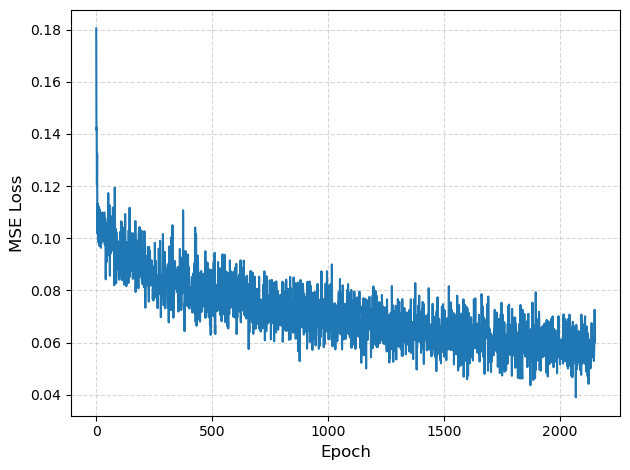

In [11]:
## Print the Training Loss
plt.clf()
plt.plot(losses_total, label="Unet training loss", linewidth=1.5)
plt.grid(True, linestyle='--', alpha=0.5)
plt.ylabel("MSE Loss", fontsize=12)
plt.xlabel("Epoch", fontsize=12)
#plt.legend(fontsize=12, loc='upper right', frameon=False)  # Turn off the legend box
plt.tight_layout()  # Adjust layout to prevent clipping labels
#plt.savefig("Loss.pdf", dpi=300, bbox_inches='tight', format='pdf')


In [22]:
# If you want to load

device = "cuda" if torch.cuda.is_available() else "cpu"

H, W = 512, 768
#H, W = 640, 1024

model = ConditionedUNet(
    dim = 128, dim_mults = (1,2,), image_size = (H//8, W//8), num_classes = 1                  # Up to 128
)

# Resume from checkpoint if available
#checkpoint_path = './models/DeepUnderWaterDiffuser_bad_data_3.pth'
checkpoint_path = './models/DeepUnderWaterDiffuser_class_conditional_9.pth'

if os.path.exists(checkpoint_path):
    checkpoint = torch.load(checkpoint_path)
    try:
        model.load_state_dict(checkpoint['ema_params'])
    except:
        print("Loading model_params, ema does not exist")
        model.load_state_dict(checkpoint['model_state_dict'])
else:
    assert False, "Checkpoint does not exist"
model.to(device)


TOTAL_TIMESTEPS = 1000
beta_t = cosine_beta_schedule(TOTAL_TIMESTEPS) # Cosine Schedule for Diffusion model
alphas = 1. - beta_t
alphas_cumprod = torch.cumprod(alphas, axis=0).to(device)

# Linear Variance schedule for the diffusion model
#beta_t = torch.linspace(0.0001, 0.02, TOTAL_TIMESTEPS).to(device)

####################

###############


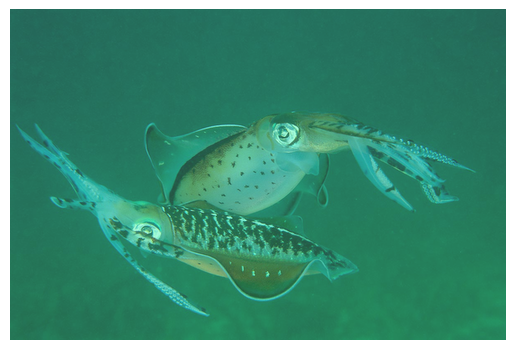

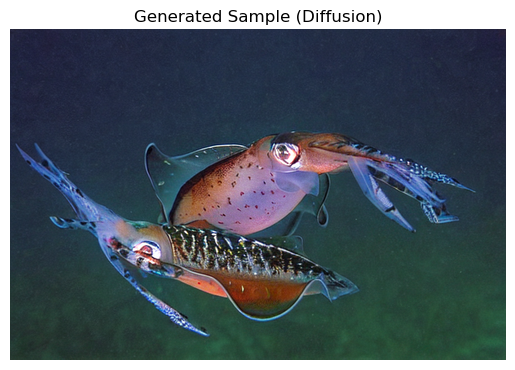

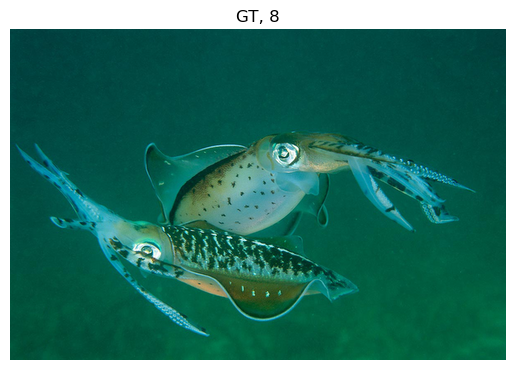

####################

###############


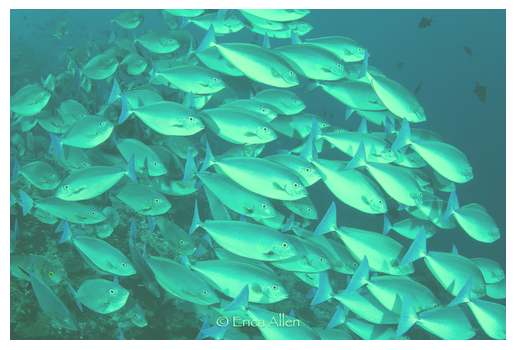

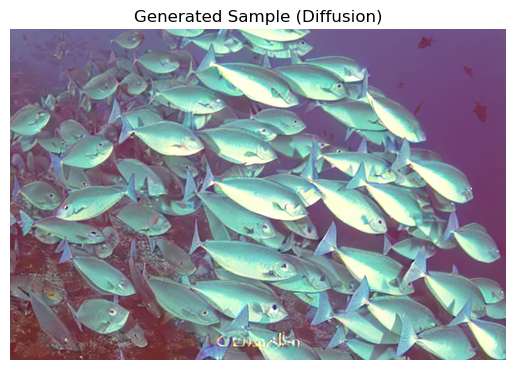

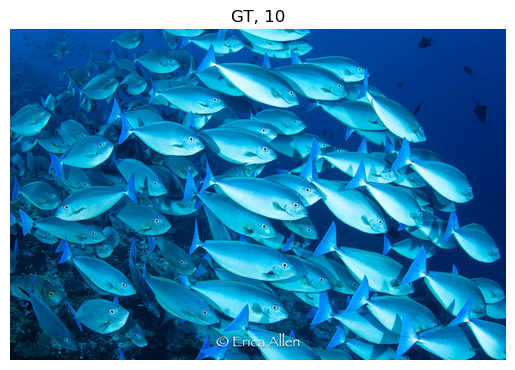

####################

###############


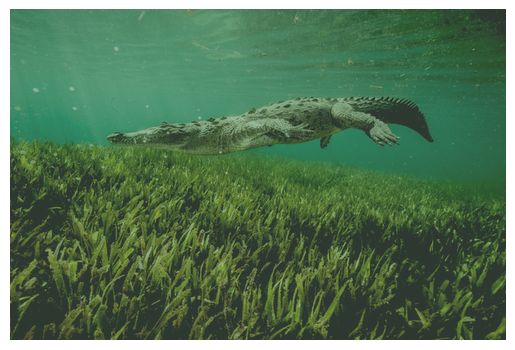

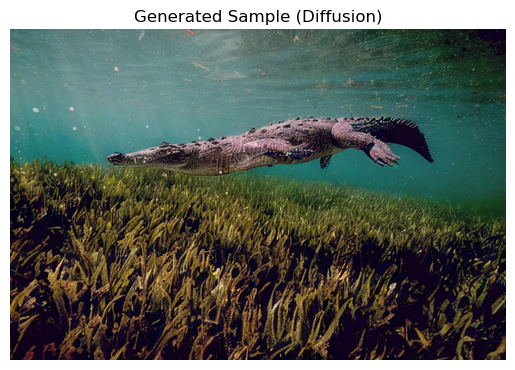

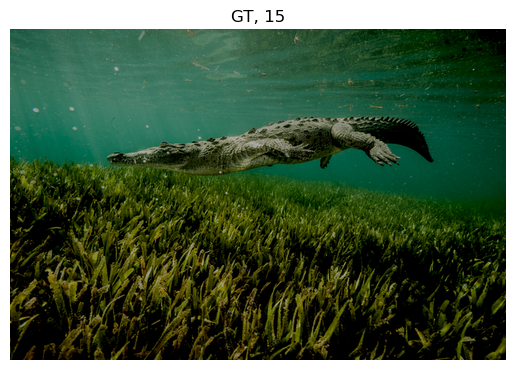

####################

###############


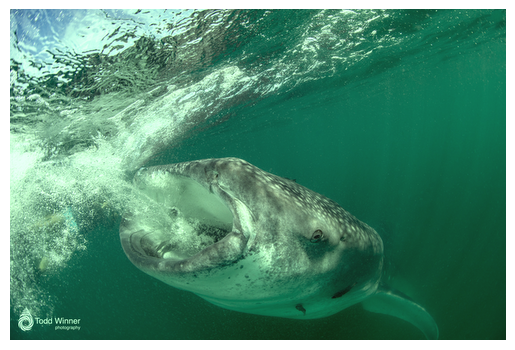

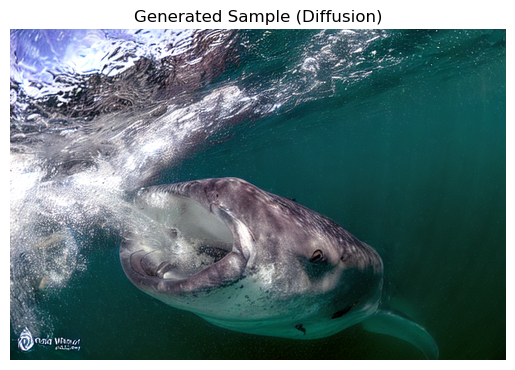

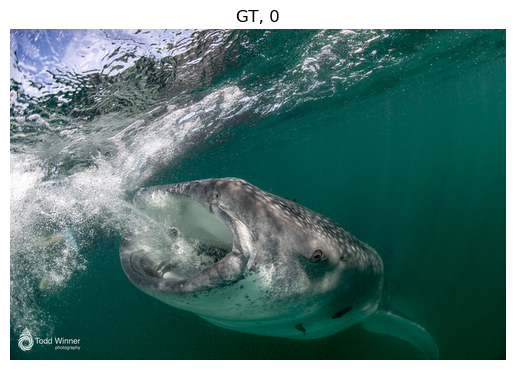

####################

###############


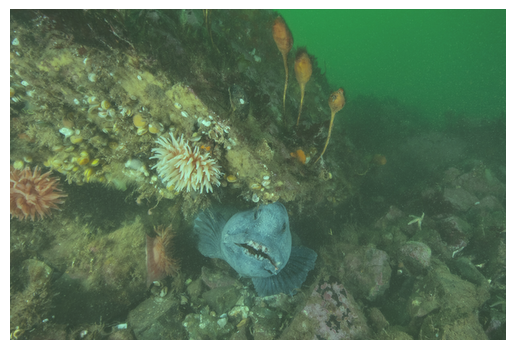

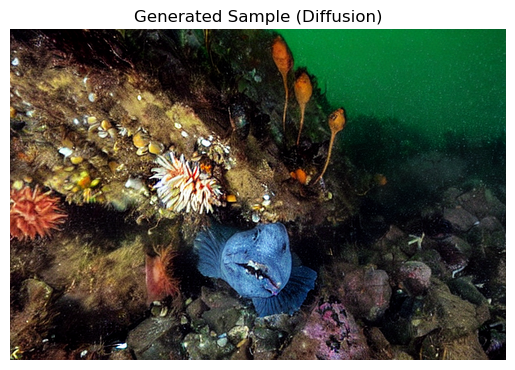

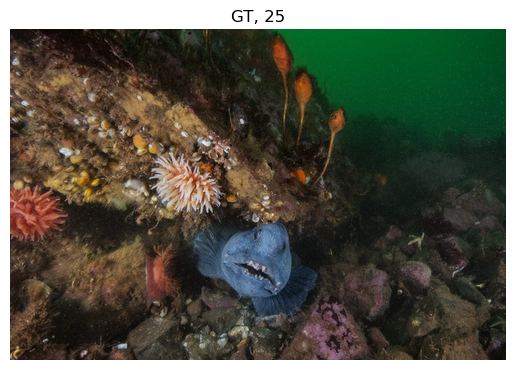

####################

###############


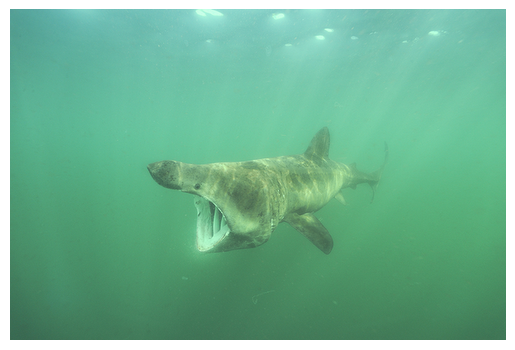

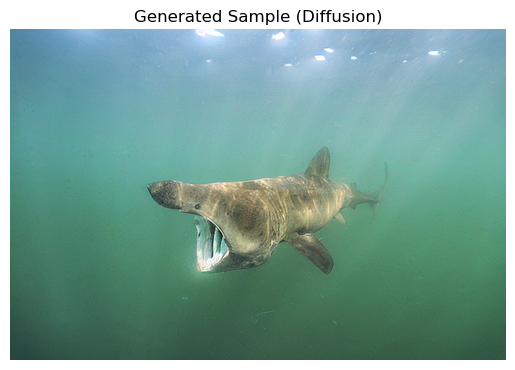

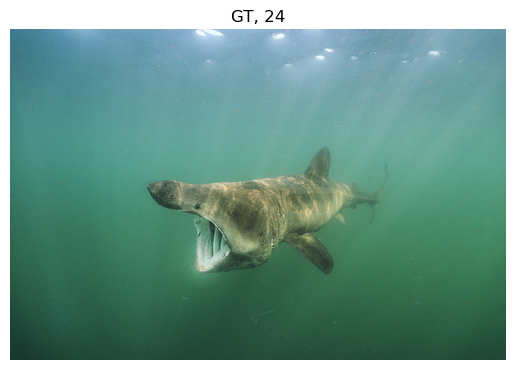

####################

###############


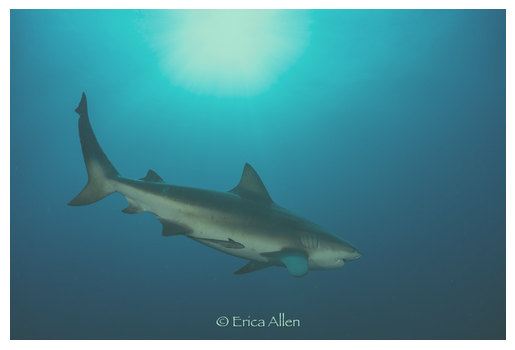

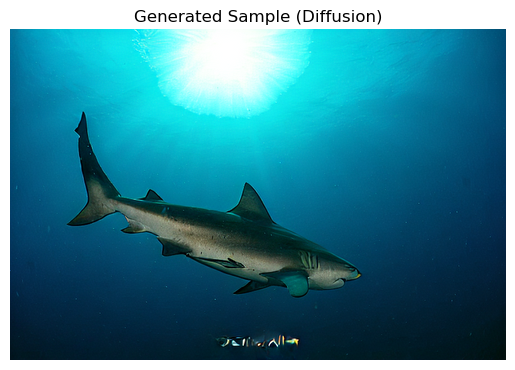

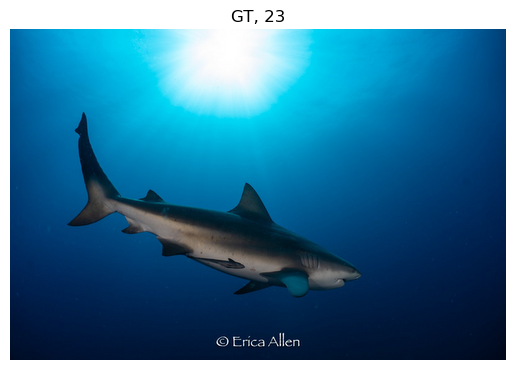

####################

###############


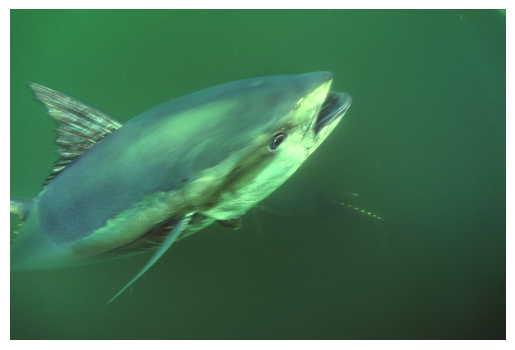

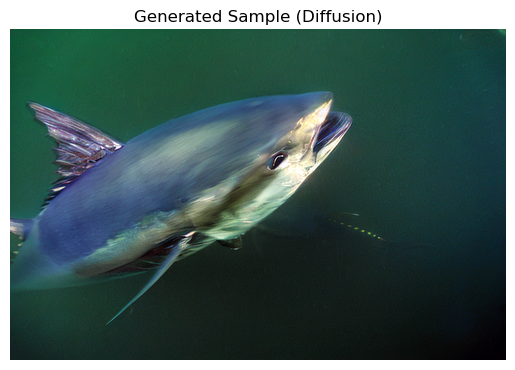

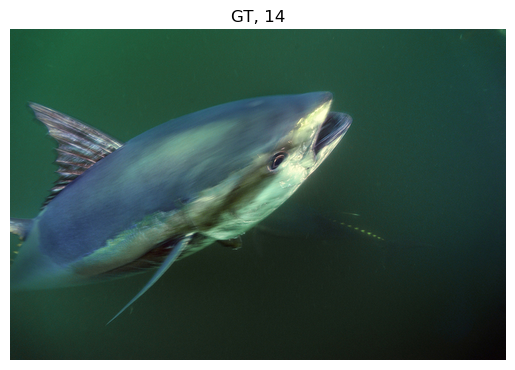

####################

###############


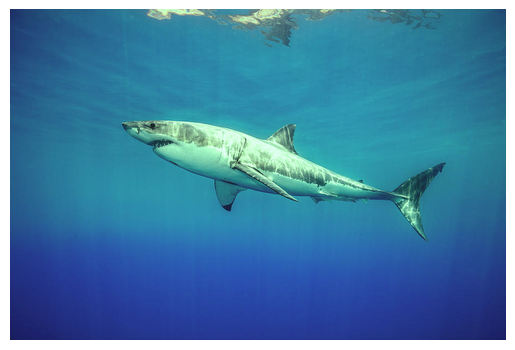

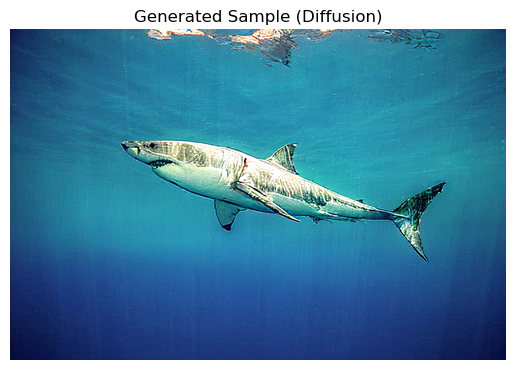

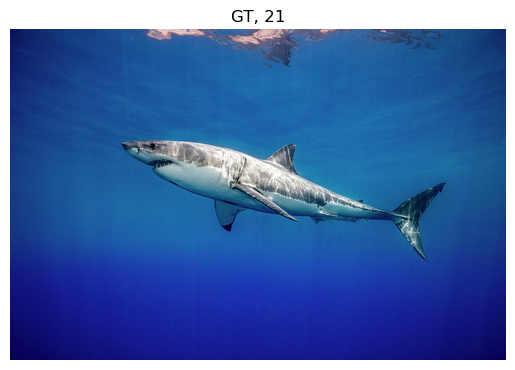

####################

###############


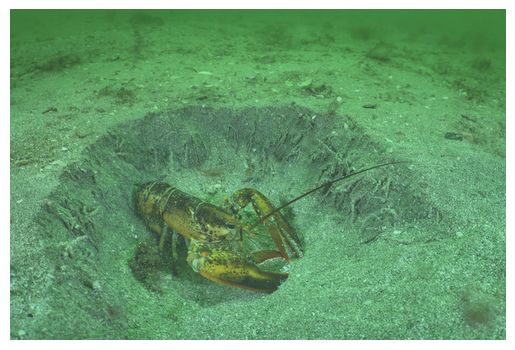

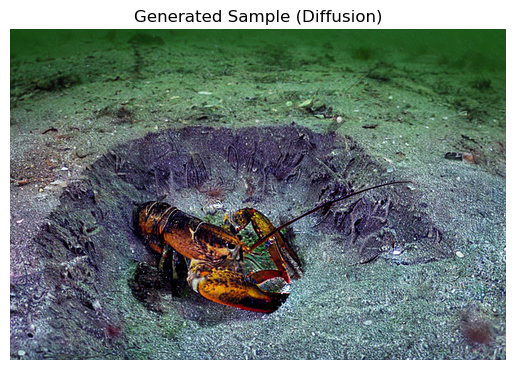

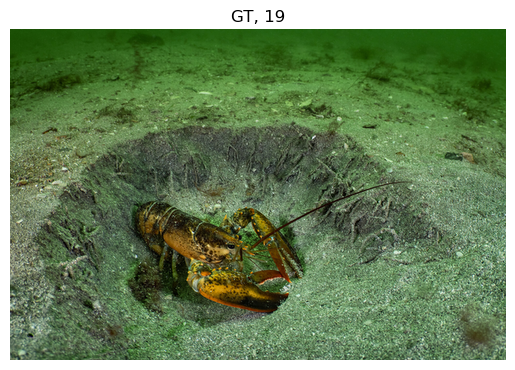

####################

###############


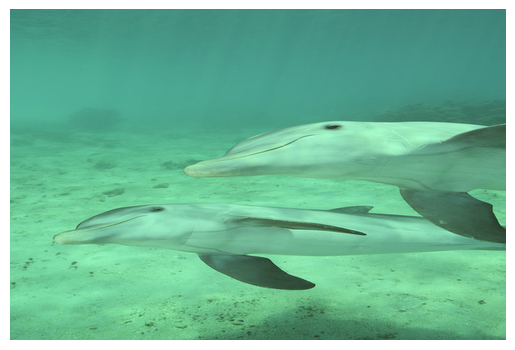

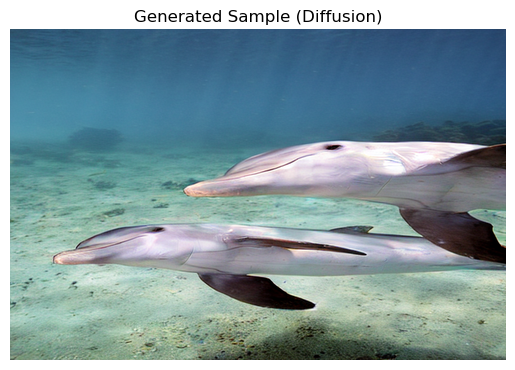

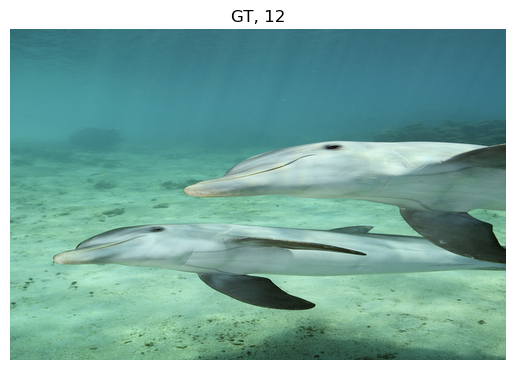

####################

###############


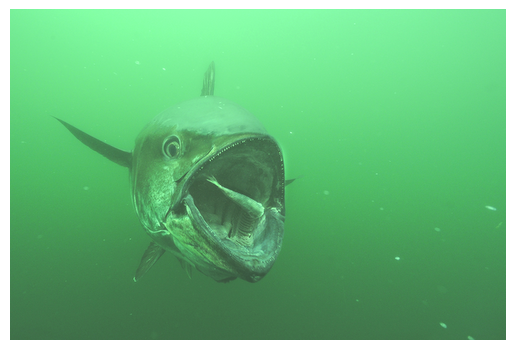

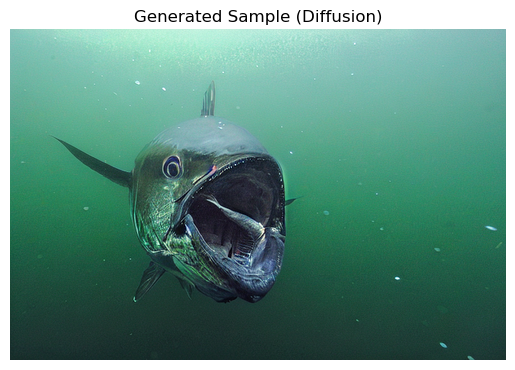

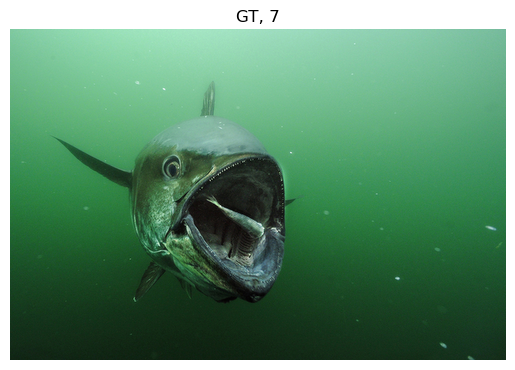

####################

###############


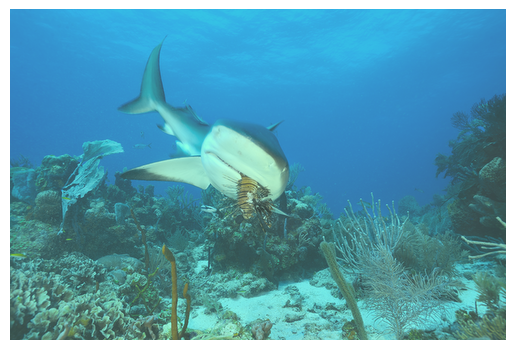

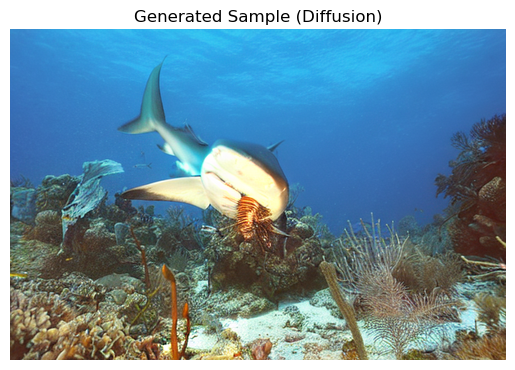

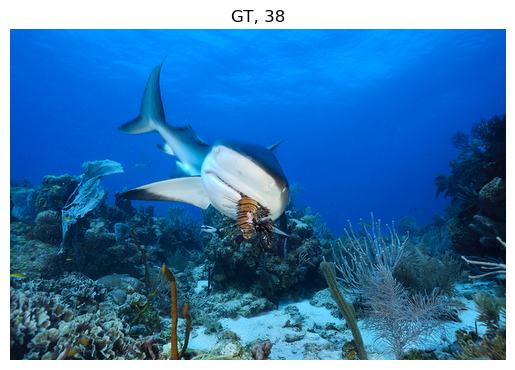

####################

###############


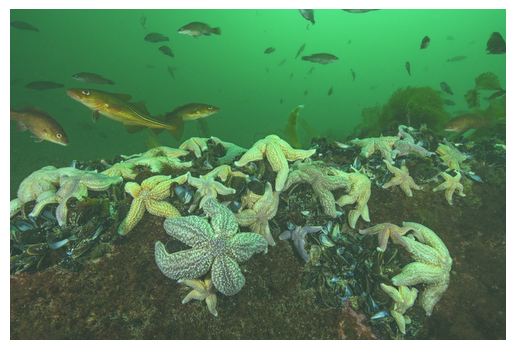

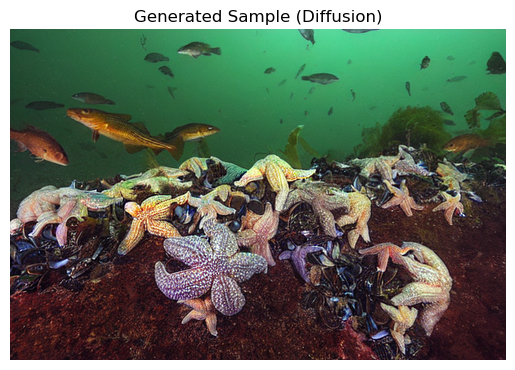

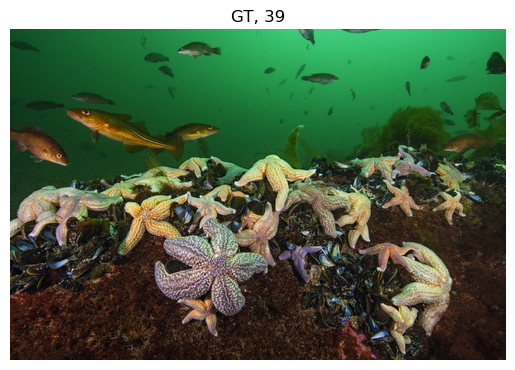

####################

###############


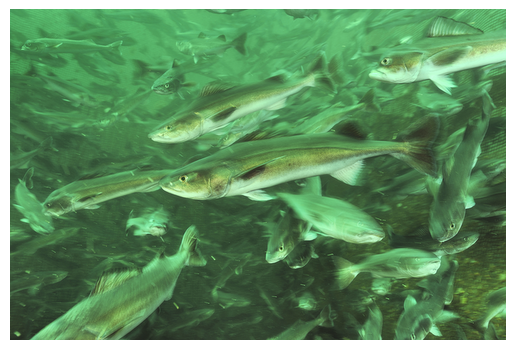

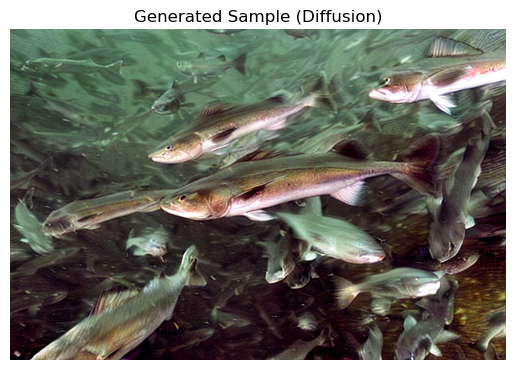

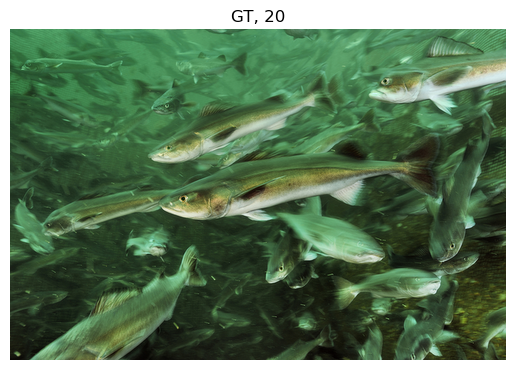

####################

###############


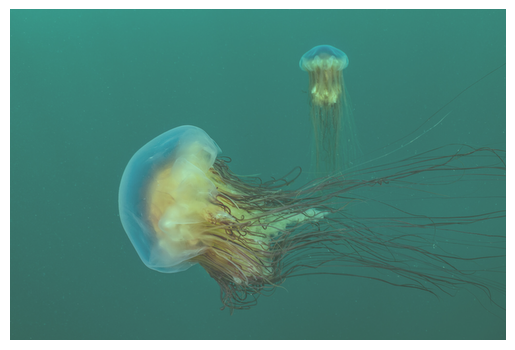

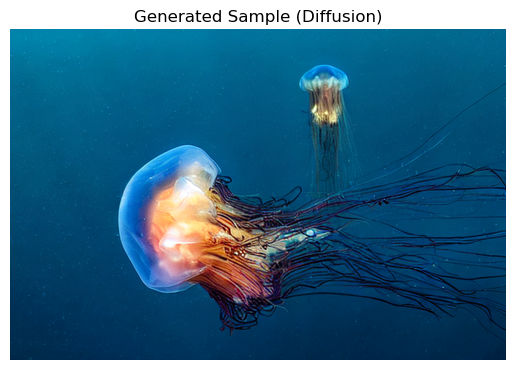

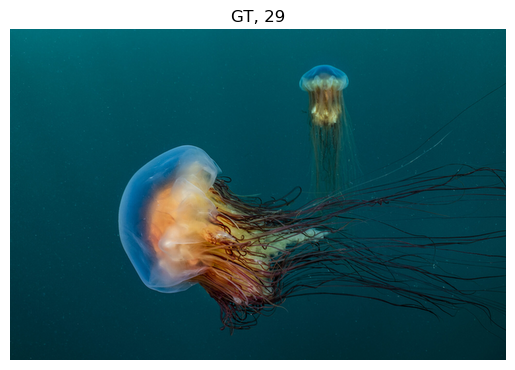

In [26]:
# Print a single sample of the generated images

with torch.no_grad():

    
    # From test data
    
    ind = torch.randint(low=0, high=len(test_images)-1, size=(16,))
    ind = ind.tolist()  # Convert indices to a list
    selected_images = [test_images[i] for i in ind]
    corrupted_image = corrupt_individually(torch.stack(selected_images), add_bubbles = False, motion_blur = False, blur_kernel_size = [2,4,8,16], apply_inpainting = True, p_inpainting = 1)
    #corrupted_image = FF.hflip(corrupted_image)
    
    ## From external
    
    ind = random.sample(range(len(batch_new_england)), 16)  # Pick N unique indices 
    #ind = [15]*4
    #ind = [0,0,0,0,4,4,4,4,15,15,15,15,18,18,18,18] #torch.randint(low = 0, high = corrupted_images.shape[0], size = (1,)) #0, 1,3,9, 14, 17, 25
    #plot_image(batch_new_england[ind[i]])
    corrupted_image = corrupt_individually(batch_new_england[ind], add_bubbles = False, motion_blur = False, blur_kernel_size = [2,4,8], apply_inpainting = False)  
    #corrupted_image = FF.hflip(corrupted_image)
    
    
    # For unconditional
    #corrupted_image = None

    samples = sample(model, corrupted_img = corrupted_image, quick = True, num_timesteps = 50, cfg_guidance = True, cfg_scale = 2.5)
    samples = samples[-1]

    for i in range(samples.shape[0]):

        print("####################\n\n###############")

        if corrupted_image is not None:
           plot_image(corrupted_image[i])

        r_samples = samples[[i]]
        #print("Samples tensor shape: ", r_samples.shape)
        #print("Generated Latent in (expected in [-3,3]):", r_samples.max(), r_samples.min(), r_samples.shape)
        r_samples = decode(r_samples).float()
        #print("Generated Image max/min:", r_samples.max().item(),r_samples.min().item(), r_samples.shape)
        
        plot_image(r_samples[0], title = "Generated Sample (Diffusion)")

        #closest_sample = find_closest_in_training(r_samples.squeeze().cpu())
        #plot_image(closest_sample)
        #plot_image(selected_images[i], f"GT, {i}")
        plot_image(batch_new_england[ind][i], f"GT, {ind[i]}")
        
        
        tosave_img = r_samples.squeeze().detach().cpu().numpy()
        tosave_img = tosave_img.transpose(1,2,0)
        tosave_img = (tosave_img*255).astype('uint8')
        tosave_img = Image.fromarray(tosave_img)
        tosave_img.save('./Generated_Jelly/myJelly' + str(i) +'.png')
        
    
    '''
    for i in range(samples.shape[0]):
            print("####################\n\n###############")
            
            if corrupted_image is not None:
                plot_image(corrupted_image[i], title="Corrupted")
        
            r_samples = samples[[i]]
            r_samples = decode(r_samples).float()
        
            gt = selected_images[i]
            gen = r_samples[0]
        
            # Compute difference image
            diff = torch.abs(gen - gt)
        
            # Plot all three in one row
            fig, axs = plt.subplots(1, 3, figsize=(18, 6))
            axs[0].imshow(gen.permute(1, 2, 0).cpu().clamp(0, 1))
            axs[0].set_title("Generated")
            axs[0].axis('off')
        
            axs[1].imshow(gt.permute(1, 2, 0).cpu().clamp(0, 1))
            axs[1].set_title("Ground Truth")
            axs[1].axis('off')
        
            axs[2].imshow(diff.permute(1, 2, 0).cpu().clamp(0, 1))
            axs[2].set_title("Absolute Difference")
            axs[2].axis('off')
        
            plt.tight_layout()
            plt.show()
    '''

In [17]:
## Load the image data into a batch tensor

def add_image_files(directory):
    for file in os.listdir(directory):
        if file.endswith('.jpg' or '.jpeg'):
            file_path = os.path.join(directory, file)
            image_files.append(file_path)

data_root = './Brian Skerry'

# Walk through the data_root directory
image_files = []
add_image_files(data_root)

totensor = transforms.Compose([
transforms.Resize((H, W), interpolation=3),
#transforms.Resize((H, W), interpolation=3),       # Resize images to the desired size
transforms.ToTensor(),           # Convert images to PyTorch tensors
])

image_tensors = []
# Loop through each image
for file in tqdm(image_files):
    image = Image.open(file)
    image = totensor(image)
    if image.shape[-1] < image.shape[-2]:
        image = torch.transpose(image,1,2)
        
    assert image.shape == (3,H,W)
    image_tensors.append(image)

# Stack the image tensors into a single tensor along the batch dimension
batch_new_england = torch.stack(image_tensors, dim=0)


100%|██████████| 40/40 [00:04<00:00,  8.51it/s]


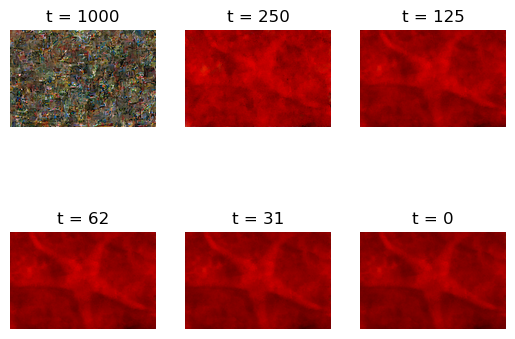

In [39]:
def get_timez(tot_t):
    timez = [tot_t, tot_t//4, tot_t//8, tot_t//16, tot_t//32, 0]
    return timez

# Generate the samples and keep time steps of interest
model.eval()
ind = torch.randint(low = 0, high = batch_tensor.shape[0], size = (1,))
corrupted_image = corrupt(batch_tensor[[ind]])
n_samples = 1
samples = sample(model, corrupted_image, num_timesteps=1000)

timez = get_timez(TOTAL_TIMESTEPS)

# Convert to torch.tensor
r_samples = torch.tensor(samples)

# Plot the output as six images in a row

kls = [(0,0), (0,1), (0,2), (1,0), (1,1), (1,2)]

fig, axs = plt.subplots(2,3)
for i in range(6):
    tsample = r_samples[TOTAL_TIMESTEPS-timez[i]]
    tsample = decode(tsample).float()
    axs[kls[i][0],kls[i][1]].imshow(tsample.squeeze().detach().cpu().permute(1,2,0), interpolation = "LANCZOS")
    axs[kls[i][0],kls[i][1]].axis("off")
    axs[kls[i][0],kls[i][1]].title.set_text("t = " + str(timez[i]))


    

In [62]:
fig.savefig("Matrix_Jelly.png")


for i,image in tqdm(enumerate(r_samples)):
    tsample = scale_output(image, xmin, xmax)
    tsample = post_process_to_image(tsample)
    tsample = tsample.squeeze().detach().cpu()#.permute(1,2,0).numpy()
    tosave_img = tsample.numpy()
    #print(tosave_img.shape)
    tosave_img = tosave_img.transpose(1,2,0)
    tosave_img = (tosave_img*255).astype('uint8')
    tosave_img = Image.fromarray(tosave_img)
    tosave_img.save('./Images_t/myJelly_'+ str(i) + '.png')


1001it [10:59,  1.52it/s]


In [ ]:
'''
# Cosine beta schedule
def cosine_beta_schedule(timesteps, s=0.008):
    """
    Cosine schedule as proposed in https://arxiv.org/abs/2102.09672
    """
    steps = timesteps + 1
    x = torch.linspace(0, timesteps, steps) / timesteps
    alphas_cumprod = torch.cos((x + s) / (1 + s) * torch.pi * 0.5) ** 2
    alphas_cumprod = alphas_cumprod / alphas_cumprod[0]  # Normalize
    betas = 1 - (alphas_cumprod[1:] / alphas_cumprod[:-1])
    return torch.clip(betas, 0.0001, 0.9999)

TOTAL_TIMESTEPS = 1000
beta_t = cosine_beta_schedule(TOTAL_TIMESTEPS).to(device)
alphas = 1. - beta_t
alphas_cumprod = torch.cumprod(alphas, axis=0)

'''

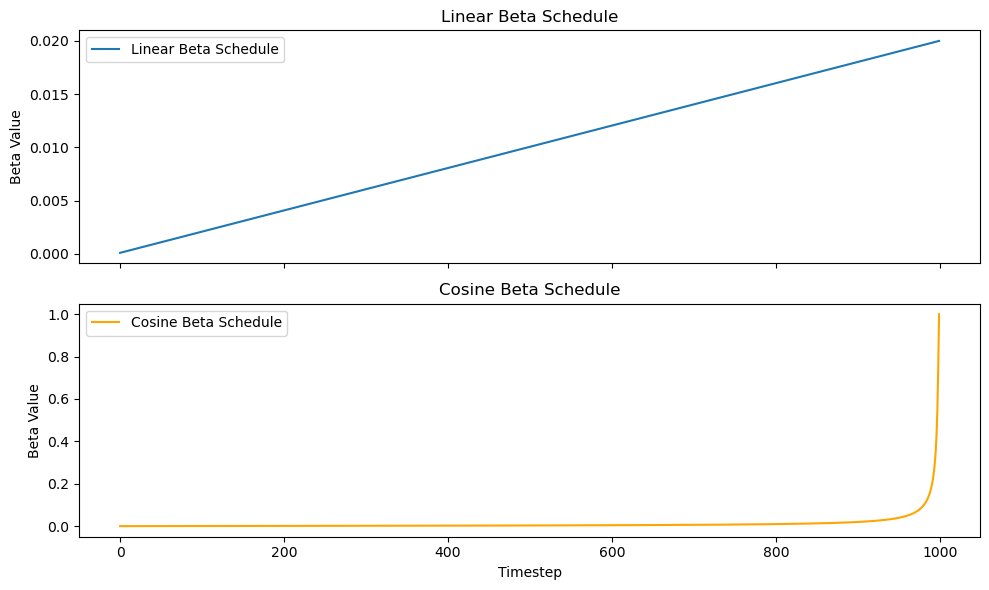

In [62]:
import matplotlib.pyplot as plt
import torch

TOTAL_TIMESTEPS = 1000

# Define beta schedules
linear_beta = torch.linspace(0.0001, 0.02, TOTAL_TIMESTEPS)
cosine_beta = cosine_beta_schedule(TOTAL_TIMESTEPS, s = 0.008)

# Plot both schedules
fig, ax = plt.subplots(2, 1, figsize=(10, 6), sharex=True)

ax[0].plot(linear_beta.cpu(), label='Linear Beta Schedule')
ax[0].set_title("Linear Beta Schedule")
ax[0].set_ylabel("Beta Value")
ax[0].legend()

ax[1].plot(cosine_beta.cpu(), label='Cosine Beta Schedule', color='orange')
ax[1].set_title("Cosine Beta Schedule")
ax[1].set_xlabel("Timestep")
ax[1].set_ylabel("Beta Value")
ax[1].legend()

plt.tight_layout()
plt.show()


NameError: name 'linear_alphas_cumprod' is not defined

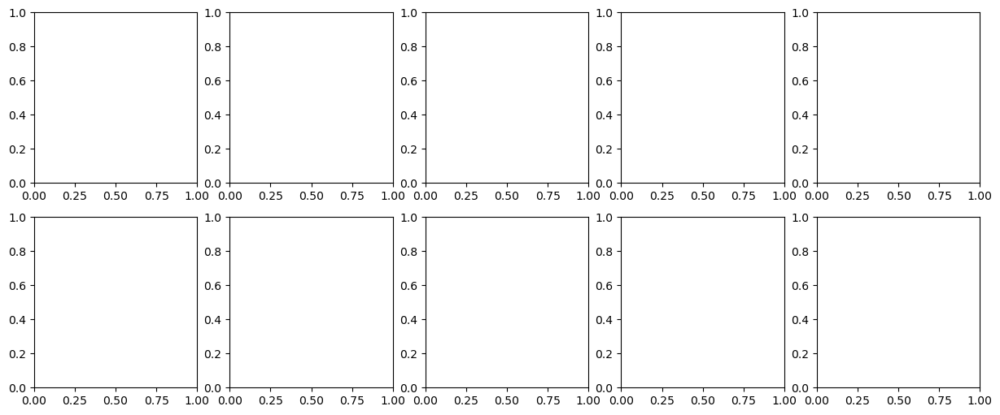

In [63]:
import matplotlib.pyplot as plt
import torch

# Assume these are defined
# def forward_sample(x_0, t, noise): ...
# def cosine_beta_schedule(T): ...

# Forward sample (noise addition)
def forward_sample(x_0, t, e, beta_t):
    def extract(a, t, x_shape):
        return a.gather(-1, t).reshape(t.shape[0], *((1,) * (len(x_shape) - 1))).to(t.device)

    alphas = 1. - beta_t
    alphas_cumprod = torch.cumprod(alphas, axis=0)
    sqrt_alphas_cumprod_t = extract(torch.sqrt(alphas_cumprod), t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = extract(torch.sqrt(1. - alphas_cumprod), t, x_0.shape)
    return sqrt_alphas_cumprod_t * x_0 + sqrt_one_minus_alphas_cumprod_t * e


TOTAL_TIMESTEPS = 1000
N = 5  # number of time steps to visualize

# Beta schedules
linear_beta = torch.linspace(0.0001, 0.02, TOTAL_TIMESTEPS).to(device)
cosine_beta = cosine_beta_schedule(TOTAL_TIMESTEPS, s = 0.005).to(device)

# Use the same image
my_img = train_images[150].unsqueeze(0).to(device)

fig, ax = plt.subplots(2, N, figsize=(3 * N, 6))

for i in range(N):
    t_scalar = i * TOTAL_TIMESTEPS // N
    t = torch.tensor([t_scalar], device=device)

    # LINEAR BETA
    beta_t = linear_beta
    alphas_cumprod = linear_alphas_cumprod
    noised_linear = forward_sample(my_img, t, torch.randn_like(my_img), linear_beta)
    img = noised_linear.squeeze(0).detach().cpu()
    ax[0, i].imshow(img[0], cmap='gray') if img.shape[0] == 1 else ax[0, i].imshow(img[:3].permute(1, 2, 0))
    ax[0, i].axis('off')
    ax[0, i].set_title(f"Linear β, t={t_scalar}")

    # COSINE BETA
    beta_t = cosine_beta
    noised_cosine = forward_sample(my_img, t, torch.randn_like(my_img), cosine_beta)
    img = noised_cosine.squeeze(0).detach().cpu()
    ax[1, i].imshow(img[0], cmap='gray') if img.shape[0] == 1 else ax[1, i].imshow(img[:3].permute(1, 2, 0))
    ax[1, i].axis('off')
    ax[1, i].set_title(f"Cosine β, t={t_scalar}")

ax[0, 0].set_ylabel("Linear Schedule", fontsize=12)
ax[1, 0].set_ylabel("Cosine Schedule", fontsize=12)

plt.tight_layout()
plt.show()


In [54]:
beta_t = cosine_beta_schedule(TOTAL_TIMESTEPS).to(device)
alphas = 1. - beta_t
alphas_cumprod = torch.cumprod(alphas, axis=0)
p_t = (1. - alphas_cumprod)
p_t = p_t / p_t.sum()  # Normalize
t = torch.multinomial(p_t, 16, replacement=True)

def sample_t(batch_size):
    p_t = (1. - alphas_cumprod)
    p_t = p_t / p_t.sum()  # Normalize
    return torch.multinomial(p_t, batch_size, replacement=True)



tensor([954, 306, 559, 806, 677, 953, 508, 924, 962, 896, 117, 186, 212, 592,
        930, 636], device='cuda:0')
